In [1]:
import os
import cv2
import random
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, cohen_kappa_score
from keras.models import Model
from keras import optimizers, applications
from keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input
from tensorflow.random import set_seed 
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [2]:
# Set random seed for reproducibility
def seed_everything(seed=0):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    set_seed(seed)

seed_everything()

In [3]:
train_df = pd.read_csv('E:/oct_dataset/oct_dataset/csv/train_data.csv')
test_df = pd.read_csv('E:/oct_dataset/oct_dataset/csv/test_data.csv')

print('Number of train samples: ', train_df.shape[0])
print('Number of test samples: ', test_df.shape[0])



Number of train samples:  83484
Number of test samples:  972


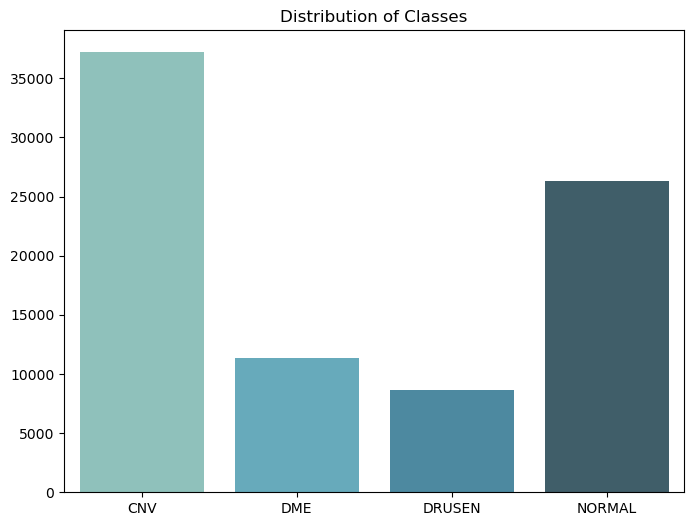

In [4]:
plt.figure(figsize=(8, 6))
sns.barplot(x=train_df.columns[1:], y=train_df.iloc[:, 1:].sum(), palette="GnBu_d")
plt.title('Distribution of Classes')
plt.show()


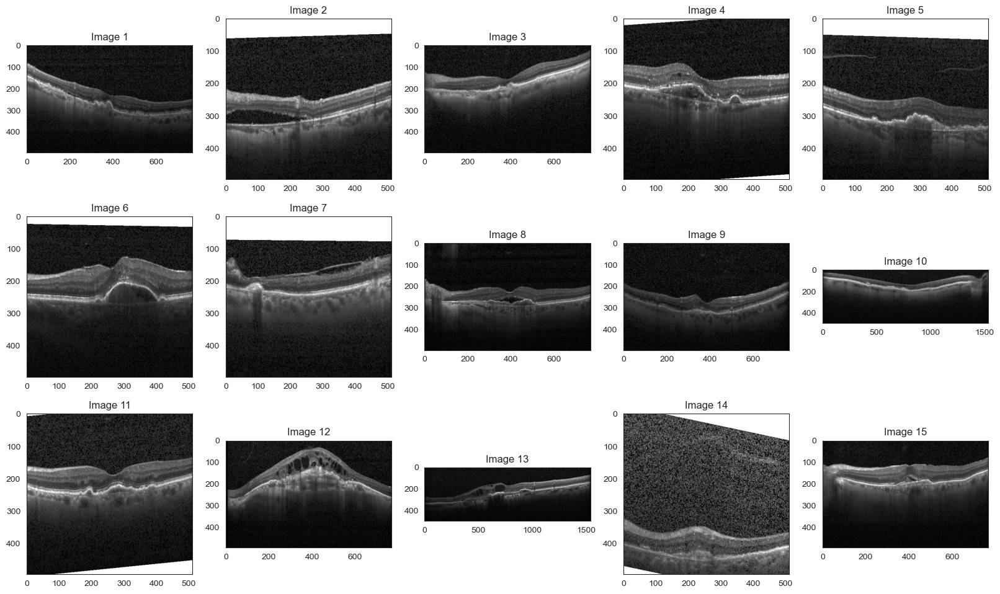

In [5]:
import cv2
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the training data CSV file
train_df = pd.read_csv("E:/oct_dataset/oct_dataset/csv/train_data.csv")

# Set the seaborn style
sns.set_style("white")

# Initialize variables
count = 1
plt.figure(figsize=[20, 20])

# Loop over image names
for img_name in train_df['id_code'][:15]:
    # Extract image identifier
    img_identifier = img_name.split('.')[0]  # Remove the file extension
    # Read the image
    img = cv2.imread("E:/oct_dataset/oct_dataset/train_images/%s.jpeg" % img_identifier)
    
    # Check if the image is read successfully
    if img is not None:
        # Create subplot
        plt.subplot(5, 5, count)
    
        # Display the image
        plt.imshow(img[..., ::-1])  # Convert BGR to RGB
        
        # Set title
        plt.title("Image %s" % count)
        
        # Increment count
        count += 1
    else:
        print(f"Unable to read image: {img_name}")

# Show the plot
plt.show()


In [1]:
import cv2
import os

# Path to the directory containing the original images
image_dir = 'E:/oct_dataset/oct_dataset/train_images'

# Path to the directory where cropped images will be saved
output_dir = 'E:/oct_dataset/oct_dataset/cropped_images/'

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

def crop_image_from_gray(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Convert image to grayscale
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    x, y, w, h = cv2.boundingRect(contours[0])
    cropped_image = image[y:y+h, x:x+w]
    return cropped_image

# Loop over each file in the image directory
for filename in os.listdir(image_dir):
    if filename.endswith('.jpeg'):
        # Read the image
        input_image = cv2.imread(os.path.join(image_dir, filename))
        
        # Check if the image was loaded successfully
        if input_image is not None:
            # Apply grayscale transformation
            gray_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
            
            # Call the function to crop the image based on the grayscale version
            cropped_image = crop_image_from_gray(input_image)
            
            # Save the cropped image
            output_path = os.path.join(output_dir, filename)
            cv2.imwrite(output_path, cropped_image)
            print(f"Cropped image saved: {output_path}")
        else:
            print(f"Error reading image: {filename}")


Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-1.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-10.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-100.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-101.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-102.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-103.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-104.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-105.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-106.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-107.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-108.jpeg
Cropped image saved: E:/oct_dataset/oct_dataset/cropped_images/CNV-1016042-109.

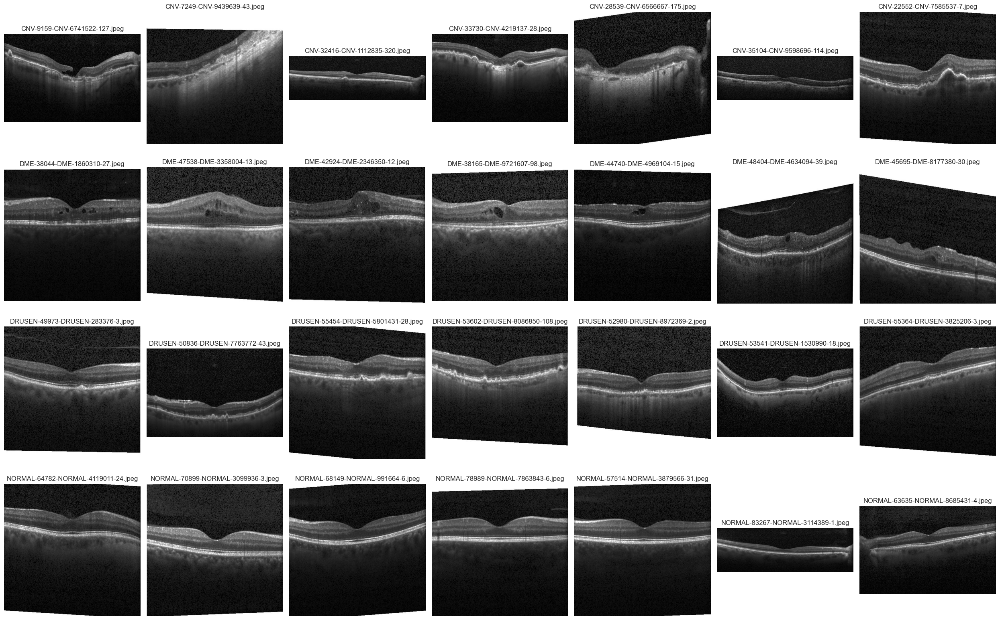

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2

SEED = 42  # You can choose any integer value as the seed
NUM_SAMP = 7
fig = plt.figure(figsize=(25, 16))
class_labels = ['CNV', 'DME', 'DRUSEN', 'NORMAL']  # Assuming these are the class labels

for class_id in class_labels:
    sampled_rows = train_df.loc[train_df[class_id] == 1].sample(min(NUM_SAMP, len(train_df)), random_state=SEED)
    for i, (idx, row) in enumerate(sampled_rows.iterrows()):
        ax = fig.add_subplot(len(class_labels), NUM_SAMP, class_labels.index(class_id) * NUM_SAMP + i + 1, xticks=[], yticks=[])
        path = f"E:/oct_dataset/oct_dataset/train_images/{row['id_code']}"
        image = cv2.imread(path)
        if image is not None:  # Check if the image was loaded successfully
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert color space to RGB
            ax.set_title('%s-%d-%s' % (class_id, idx, row['id_code']))
            plt.axis('off')  # Turn off axis
        else:
            print(f"Error reading image: {path}")
plt.tight_layout()
plt.show()


In [10]:

train_source_path = 'E:/oct_dataset/oct_dataset/cropped_images/'
test_source_path = 'E:/oct_dataset/oct_dataset/test_images/'

train_dest_path = "E:/oct_dataset/oct_dataset/final_datasets/train_images/"
test_dest_path = "E:/oct_dataset/oct_dataset/final_datasets/test_images/"




In [11]:

def process_image_folder(df, source_path, dest_path):
    for i, (idx, row) in enumerate(df.iterrows()):
        img_path = f"{source_path}{row['id_code']}"  # Assuming the images are in JPEG format
        dest_img_path = f"{dest_path}{row['id_code']}"
        
        # Read the image
        image = cv2.imread(img_path)
        
        # Check if the image was read successfully
        if image is not None:
            # Write the image to the destination path
            cv2.imwrite(dest_img_path, image)
            print(f"Image processed and saved: {dest_img_path}")
        else:
            print(f"Error reading image: {img_path}")


In [12]:
process_image_folder(train_df,train_source_path,train_dest_path)

Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-8086850-26.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-1908313-34.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-3956332-5.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-5904584-45.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-9238054-24.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-1322624-149.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-3571267-8.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-1112835-232.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images/CNV-5557306-157.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/train_images

In [13]:
process_image_folder(test_df,test_source_path,test_dest_path)

Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-338282-1.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-6053140-1.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-5824631-1.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-2692822-1.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-53018-1.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-81630-2.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-1997439-7.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-172472-7.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-1699976-4.jpeg
Image processed and saved: E:/oct_dataset/oct_dataset/final_datasets/test_images/CNV-3459091-1.jpeg
Image 

In [14]:
processed_src_path = "E:/oct_dataset/oct_dataset/final_datasets/train_images/"
new_dest_path = 'E:/oct_dataset/oct_dataset/data_final_all/'

In [15]:
import os
import cv2

# Ensure the destination directory exists
os.makedirs(new_dest_path, exist_ok=True)

def create_dataset(df, source_path, dest_path):
    for i, (idx, row) in enumerate(df.iterrows()):
        img_path = f"{source_path}{row['id_code']}"  # Assuming images are in JPEG format
        dest_img_path = f"{dest_path}{row['id_code']}"  # Assuming 'LABEL' contains class labels
        
        # Read the image from the source path
        image = cv2.imread(img_path)

        # Ensure the destination subdirectory exists
        os.makedirs(os.path.dirname(dest_img_path), exist_ok=True)

        # Save the image to the destination path with the corresponding subdirectory
        cv2.imwrite(dest_img_path, image)

# Call the function with appropriate arguments
create_dataset(train_df, processed_src_path, new_dest_path)


In [16]:
import os
import shutil
import pandas as pd

# Define the source directory containing the original images
source_dir = 'E:/oct_dataset/oct_dataset/data_final_all/'

# Read the CSV file containing image information
data_df = pd.read_csv('E:/oct_dataset/oct_dataset/csv/train_data.csv')  # Replace 'path_to_your_csv_file.csv' with the actual path

# Create the target directories if they don't exist
target_dirs = ['CNV', 'DME', 'DRUSEN', 'NORMAL']
for target_dir in target_dirs:
    os.makedirs(os.path.join(source_dir, target_dir), exist_ok=True)

# Iterate over each row in the DataFrame and move images to their respective directories
for index, row in data_df.iterrows():
    image_name = row['id_code']
    for target_dir in target_dirs:
        if row[target_dir] == 1:
            class_label = target_dir
            break
    
    # Construct source and destination paths
    src_path = os.path.join(source_dir, image_name)
    dest_path = os.path.join(source_dir, class_label, image_name)
    
    # Move the image to the respective class directory
    shutil.move(src_path, dest_path)
    
print("Images have been classified and moved to their respective folders.")


Images have been classified and moved to their respective folders.
